In [ ]:
#@title **Instalación de librerías necesarias**

!pip install -q ultralytics roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 26.1 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.8/85.8 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 34.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 92.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 1.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 29.9 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
#@title **Importar librerías**
from roboflow import Roboflow
from ultralytics import YOLO
import os
import matplotlib.pyplot as plt
from IPython.display import Image, display

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


### 📁 Preparación del Dataset desde Roboflow

Este bloque se encarga de conectar con Roboflow, descargar un dataset compatible con YOLOv9 y filtrar únicamente las clases de interés para crear un nuevo dataset personalizado.

#### 🔗 1. Conexión y descarga desde Roboflow
- Se establece conexión con Roboflow utilizando una API Key personal.
- Se selecciona el proyecto `"enfermedades-en-limon-persa-ldtje"` dentro del workspace `"ia-pbu8p"`.
- Se descarga la versión 1 del dataset en formato compatible con YOLOv9.

#### 🧹 2. Filtrado de clases
- Se seleccionan únicamente dos clases objetivo: `"Hoja huanglongbing"` y `"Limon persa"`.
- Se crea un mapeo que reindexa estas clases a `[0, 1]` para simplificar el entrenamiento posterior.

#### 🗂️ 3. Estructura del nuevo dataset
- Se genera la estructura de carpetas para entrenamiento (`train`), validación (`valid`) y prueba (`test`) con sus respectivas subcarpetas de imágenes y etiquetas.
- Se recorren las etiquetas del dataset original y se copian solo aquellas anotaciones que pertenecen a las clases seleccionadas.
- Se copian las imágenes correspondientes y se guardan los nuevos archivos de etiquetas.

#### 📄 4. Creación del archivo `data.yaml`
- Se genera un nuevo archivo `data.yaml` con la ruta, divisiones del dataset, cantidad de clases (`nc`) y sus nombres.
- Este archivo es esencial para entrenar modelos YOLO con Ultralytics.

> ✅ Al finalizar, se imprime la confirmación con la ruta del nuevo dataset creado: `dataset_yolov9_2clases/`.


In [ ]:
# Conexión con la cuenta de Roboflow usando la API key
rf = Roboflow(api_key="Onm8meg1R1ujZoE5XGHL")

# Selección del proyecto y dataset desde el workspace
project = rf.workspace("ia-pbu8p").project("enfermedades-en-limon-persa-ldtje")
dataset = project.version(1).download("yolov9")  # Descarga en formato compatible con YOLOv9

# Ruta al archivo data.yaml, necesario para entrenamiento con YOLO
data_yaml = os.path.join(dataset.location, "data.yaml")
print("Ruta del data.yaml:", data_yaml)

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Enfermedades-en-limon-persa-1 in yolov9:: 100%|██████████| 6750/6750 [00:04<00:00, 1539.45it/s]


Ruta del data.yaml: /kaggle/working/Enfermedades-en-limon-persa-1/data.yaml


In [ ]:
import os
import shutil
import yaml

# Ruta del dataset original descargado desde Roboflow
dataset_orig = dataset.location

# Clases que se desean conservar en el nuevo dataset
clases_objetivo = ["Hoja huanglongbing", "Limon persa"]

# Nombre del nuevo dataset filtrado
nuevo_dataset = "dataset_yolov9_2clases"

# Leer el archivo data.yaml original para obtener los nombres de todas las clases
with open(os.path.join(dataset_orig, "data.yaml"), 'r') as f:
    data = yaml.safe_load(f)
all_classes = data['names']

# Crear un mapeo de los índices originales a los nuevos (0 y 1)
idx_map = { all_classes.index(c): i for i, c in enumerate(clases_objetivo) }

# Crear estructura de carpetas para el nuevo dataset
for split in ("train", "valid", "test"):
    os.makedirs(os.path.join(nuevo_dataset, split, "images"), exist_ok=True)
    os.makedirs(os.path.join(nuevo_dataset, split, "labels"), exist_ok=True)

# Recorrer cada división del dataset original
for split in ("train", "valid", "test"):
    img_dir = os.path.join(dataset_orig, split, "images")
    lbl_dir = os.path.join(dataset_orig, split, "labels")

    for fname in os.listdir(lbl_dir):
        if not fname.endswith(".txt"):
            continue  # Saltar archivos que no sean etiquetas

        orig_lbl = os.path.join(lbl_dir, fname)
        nuevas_lineas = []

        # Leer y filtrar anotaciones que correspondan a las clases objetivo
        with open(orig_lbl) as lf:
            for linea in lf:
                parts = linea.strip().split()
                cls = int(parts[0])
                if cls in idx_map:
                    new_cls = idx_map[cls]
                    nuevas_lineas.append(" ".join([str(new_cls)] + parts[1:]))

        # Si se encontraron anotaciones válidas, copiar imagen y guardar nuevo archivo de etiquetas
        if nuevas_lineas:
            base_name = fname[:-4]  # nombre sin extensión .txt

            # Buscar imagen correspondiente (puede ser .jpg, .jpeg o .png)
            for ext in (".jpg", ".jpeg", ".png"):
                posible_img = os.path.join(img_dir, base_name + ext)
                if os.path.exists(posible_img):
                    src_img = posible_img
                    break
            else:
                raise FileNotFoundError(f"No se encontró la imagen para {base_name} en {img_dir}")

            # Definir rutas de destino
            dst_img = os.path.join(nuevo_dataset, split, "images", os.path.basename(src_img))
            dst_lbl = os.path.join(nuevo_dataset, split, "labels", fname)

            # Copiar imagen
            shutil.copy2(src_img, dst_img)
            # Escribir archivo de etiquetas filtrado
            with open(dst_lbl, 'w') as out:
                out.write("\n".join(nuevas_lineas))

# Crear el nuevo archivo data.yaml para el dataset filtrado
nuevo_data = {
    'path': nuevo_dataset,
    'train': os.path.join("train", "images"),
    'val':   os.path.join("valid", "images"),
    'nc':    len(clases_objetivo),
    'names': clases_objetivo
}
with open(os.path.join(nuevo_dataset, "data.yaml"), 'w') as f:
    yaml.dump(nuevo_data, f, sort_keys=False)

print(f"✔ Dataset filtrado creado en: {nuevo_dataset}/")

✔ Dataset filtrado creado en: dataset_yolov9_2clases/


### 🚀 Entrenamiento, Evaluación e Inferencia con YOLOv9 (2 clases)

Este bloque describe el proceso completo de entrenamiento de un modelo YOLOv9-tiny con un dataset personalizado, seguido de la visualización de métricas, evaluación sobre un conjunto de prueba, e inferencia sobre imágenes reales.

---

#### 🧠 1. Entrenamiento del modelo
- Se carga el modelo base preentrenado `yolov9t.pt`.
- Se entrena sobre el dataset filtrado de 2 clases (`Hoja huanglongbing`, `Limon persa`).
- Se usa una resolución de imagen de 640x640, 50 épocas y un batch size de 18.
- El modelo se entrena utilizando 2 GPUs (`device=[0, 1]`).
- Los resultados del entrenamiento se almacenan en: `runs/detect/limon_detector_yolov9/`.

---

#### 📈 2. Visualización de métricas de entrenamiento
- Se muestra el gráfico de métricas generado por Ultralytics (`results.png`), el cual incluye:
  - Pérdida de clasificación y localización
  - Precisión (Precision)
  - Recall
  - mAP@0.5 y mAP@0.5:0.95

---

#### 📊 3. Extracción de métricas numéricas
- Se carga el archivo `results.csv` generado por Ultralytics.
- Se imprimen los valores de la última época para métricas clave:
  - `train/box_loss`, `val/box_loss`
  - `precision(B)`, `recall(B)`
  - `mAP50(B)`, `mAP50-95(B)`

---

#### 🔍 4. Inferencia sobre una imagen aleatoria del conjunto de validación
- Se selecciona una imagen aleatoria desde `valid/images`.
- Se realiza una predicción con el modelo entrenado y se guarda la imagen anotada.
- Se visualiza la imagen con `matplotlib` mostrando las detecciones realizadas por el modelo.
- El código incluye los nombres de todas las clases del dataset original (para análisis referencial).

---

#### ⚙️ 5. Habilitación del conjunto de prueba (`test`) en `data.yaml`
- Se edita el archivo `dataset_yolov9_2clases/data.yaml` para incluir la ruta al conjunto de prueba.
- Esto permite evaluar formalmente el modelo sobre `test/images`.

---

#### 🧪 6. Evaluación del modelo sobre el conjunto de prueba
- Se usa `model.val()` para evaluar el modelo sobre el split de `test` del dataset de 2 clases.
- Se generan gráficos y se guardan automáticamente:
  - `confusion_matrix.png`, `PR_curve.png`, `results.png`, `val_batch0_pred.jpg`.
- Se imprimen las métricas principales del conjunto de prueba:
  - Precisión media (`mp`), Recall (`mr`), mAP@0.5 y mAP@0.5:0.95.

---

#### 🖼️ 7. Visualización de una predicción puntual en el conjunto de prueba
- Se selecciona aleatoriamente una imagen desde `test/images`.
- Se realiza inferencia con el modelo entrenado.
- Se visualiza la imagen con anotaciones generadas por el modelo.
- Se imprime en texto cada detección: clase, confianza y coordenadas del bounding box.

---


In [ ]:
# Cargar el modelo base YOLOv9-tiny preentrenado
modelo = YOLO("yolov9t.pt")

# Entrenar el modelo con el dataset filtrado
modelo.train(
    data="dataset_yolov9_2clases/data.yaml",  # Ruta al archivo de configuración del dataset
    epochs=50,                                # Número de épocas de entrenamiento
    imgsz=640,                                # Tamaño de las imágenes (640x640)
    batch=18,                                 # Tamaño del batch por iteración
    name="limon_detector_yolov9",             # Nombre del experimento (carpeta de salida)
    device=[0, 1]                              # Usar GPU 0 y 1 (ajustar según disponibilidad)
)

100%|██████████| 4.74M/4.74M [00:00<00:00, 91.0MB/s]


Ultralytics 8.3.146 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
                                                        CUDA:1 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=18, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset_yolov9_2clases/data.yaml, degrees=0.0, deterministic=True, device=0,1, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov9t.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=limon_detector_yolov9, nbs=64, nms=False, opset=None, optimize=Fal

100%|██████████| 755k/755k [00:00<00:00, 20.7MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7872  ultralytics.nn.modules.block.ELAN1           [32, 32, 32, 16]              
  3                  -1  1     18560  ultralytics.nn.modules.block.AConv           [32, 64]                      
  4                  -1  1     65216  ultralytics.nn.modules.block.RepNCSPELAN4    [64, 64, 64, 32, 3]           
  5                  -1  1     55488  ultralytics.nn.modules.block.AConv           [64, 96]                      
  6                  -1  1    145824  ultralytics.nn.modules.block.RepNCSPELAN4    [96, 96, 96, 48, 3]           
  7                  -1  1    110848  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 110MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3759.5±772.1 MB/s, size: 586.4 KB)


train: Scanning /kaggle/working/dataset_yolov9_2clases/train/labels... 2772 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2772/2772 [00:02<00:00, 1183.37it/s]


train: New cache created: /kaggle/working/dataset_yolov9_2clases/train/labels.cache
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 8827, len(boxes) = 24094. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1762.1±1613.6 MB/s, size: 593.3 KB)


val: Scanning /kaggle/working/dataset_yolov9_2clases/valid/labels... 234 images, 0 backgrounds, 0 corrupt: 100%|██████████| 234/234 [00:00<00:00, 1276.68it/s]


val: New cache created: /kaggle/working/dataset_yolov9_2clases/valid/labels.cache
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 483, len(boxes) = 1883. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
Plotting labels to runs/detect/limon_detector_yolov9/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 221 weight(decay=0.0), 228 weight(decay=0.0005625000000000001), 227 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/limon_detector_yolov9
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.02G      2.054      3.143      1.463         99        640: 100%|██████████| 154/154 [01:00<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.18it/s]


                   all        234       1883      0.328      0.102      0.107     0.0548

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.03G      1.915      2.653      1.368         91        640: 100%|██████████| 154/154 [00:55<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.12it/s]


                   all        234       1883      0.216      0.189      0.112     0.0472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.04G      1.882      2.568      1.347         97        640: 100%|██████████| 154/154 [00:55<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.22it/s]


                   all        234       1883      0.319      0.175      0.147     0.0721

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.23G      1.842      2.523      1.343        139        640: 100%|██████████| 154/154 [00:54<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.95it/s]


                   all        234       1883      0.221      0.212      0.133     0.0658

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.24G      1.824      2.475      1.323        157        640: 100%|██████████| 154/154 [00:53<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.31it/s]


                   all        234       1883       0.27      0.228      0.155     0.0784

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.25G      1.761      2.384      1.305        164        640: 100%|██████████| 154/154 [00:54<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.36it/s]


                   all        234       1883      0.228      0.221      0.137     0.0708

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.26G      1.783      2.362      1.281        118        640: 100%|██████████| 154/154 [00:54<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.15it/s]


                   all        234       1883      0.281      0.259      0.171     0.0837

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.28G      1.731      2.331      1.276        129        640: 100%|██████████| 154/154 [00:53<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.30it/s]


                   all        234       1883      0.286      0.225       0.15     0.0812

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.29G       1.72      2.332      1.296        184        640: 100%|██████████| 154/154 [00:53<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.86it/s]


                   all        234       1883      0.321      0.247      0.185     0.0918

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50       2.3G      1.729      2.287      1.263         92        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.88it/s]


                   all        234       1883      0.271      0.244      0.159     0.0813

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.31G      1.675       2.19      1.252        188        640: 100%|██████████| 154/154 [00:54<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.58it/s]


                   all        234       1883      0.253      0.221      0.148     0.0731

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.32G      1.651      2.217      1.239        167        640: 100%|██████████| 154/154 [00:54<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.28it/s]


                   all        234       1883      0.287      0.269      0.173     0.0877

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.34G      1.641      2.144      1.243        131        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.25it/s]


                   all        234       1883       0.27      0.265      0.174     0.0891

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.35G      1.654      2.186      1.264        135        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.20it/s]


                   all        234       1883      0.305      0.252      0.184     0.0953

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.36G      1.639      2.147      1.232        155        640: 100%|██████████| 154/154 [00:54<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.24it/s]


                   all        234       1883      0.304      0.256      0.183     0.0925

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.38G       1.61      2.121      1.216        136        640: 100%|██████████| 154/154 [00:53<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.15it/s]


                   all        234       1883        0.3      0.246       0.18     0.0933

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.38G      1.603      2.102       1.22        128        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.50it/s]


                   all        234       1883      0.276      0.264      0.178     0.0893

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50       2.4G      1.605      2.116      1.217        106        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.45it/s]


                   all        234       1883      0.306      0.249       0.18     0.0922

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.41G      1.571      1.996      1.213        155        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.22it/s]


                   all        234       1883      0.274      0.276      0.187      0.094

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.42G      1.574      1.988      1.199        106        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.11it/s]


                   all        234       1883      0.278       0.26      0.184     0.0919

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.44G      1.547       1.98      1.193        152        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.15it/s]


                   all        234       1883       0.26       0.24       0.15      0.077

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.45G      1.545      1.962      1.201        136        640: 100%|██████████| 154/154 [00:53<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.91it/s]


                   all        234       1883      0.307      0.275      0.192     0.0997

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.46G      1.539      1.951      1.203        137        640: 100%|██████████| 154/154 [00:53<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.40it/s]


                   all        234       1883       0.27      0.275      0.182     0.0927

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.47G      1.528      1.924      1.181        194        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.46it/s]


                   all        234       1883      0.238       0.25      0.144     0.0764

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.48G      1.531      1.891      1.184        155        640: 100%|██████████| 154/154 [00:53<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.41it/s]


                   all        234       1883      0.311      0.262      0.188     0.0967

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.49G      1.507      1.854      1.168         83        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.65it/s]


                   all        234       1883      0.283      0.265      0.173     0.0848

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.51G      1.543      1.867      1.166        117        640: 100%|██████████| 154/154 [00:53<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.49it/s]


                   all        234       1883      0.282      0.262       0.18     0.0934

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.52G      1.519      1.867      1.176        110        640: 100%|██████████| 154/154 [00:54<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.22it/s]


                   all        234       1883      0.295      0.263      0.178     0.0907

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.53G      1.513      1.818      1.166        140        640: 100%|██████████| 154/154 [00:54<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.41it/s]


                   all        234       1883      0.276      0.281      0.174     0.0899

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.54G      1.494        1.8      1.161        139        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.17it/s]


                   all        234       1883      0.277      0.287      0.181     0.0951

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.55G      1.479      1.739      1.138        154        640: 100%|██████████| 154/154 [00:53<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.55it/s]


                   all        234       1883      0.304       0.28      0.192        0.1

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.57G      1.454      1.729      1.162         98        640: 100%|██████████| 154/154 [00:54<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.69it/s]


                   all        234       1883      0.325       0.28      0.199      0.102

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.58G      1.448      1.729      1.146        125        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.41it/s]


                   all        234       1883      0.291      0.288      0.182     0.0926

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.59G      1.456      1.672      1.121        174        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.41it/s]


                   all        234       1883      0.298      0.277      0.191      0.101

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50       2.6G      1.441      1.703      1.144         96        640: 100%|██████████| 154/154 [00:53<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.18it/s]


                   all        234       1883      0.291      0.275      0.194     0.0987

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.62G      1.434       1.69       1.15        151        640: 100%|██████████| 154/154 [00:54<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.35it/s]


                   all        234       1883      0.303      0.263      0.183     0.0919

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.63G      1.451      1.689      1.138        185        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.37it/s]


                   all        234       1883      0.289      0.292      0.197      0.102

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.64G       1.42      1.638      1.135         97        640: 100%|██████████| 154/154 [00:54<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.25it/s]


                   all        234       1883      0.295      0.283      0.193     0.0998

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.65G      1.423       1.61      1.122        123        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.41it/s]


                   all        234       1883      0.279      0.306      0.195        0.1

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.66G      1.401        1.6      1.123        144        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.50it/s]


                   all        234       1883      0.288      0.282       0.19     0.0987
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.68G      1.418      1.578      1.095         50        640: 100%|██████████| 154/154 [00:56<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.55it/s]


                   all        234       1883      0.293      0.284      0.195     0.0988

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.69G      1.376      1.475      1.075         53        640: 100%|██████████| 154/154 [00:53<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.20it/s]


                   all        234       1883      0.324      0.282      0.195     0.0991

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50       2.7G      1.355      1.386      1.058         42        640: 100%|██████████| 154/154 [00:53<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.58it/s]


                   all        234       1883      0.296        0.3      0.197      0.101

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.71G      1.379      1.425      1.081         59        640: 100%|██████████| 154/154 [00:52<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.93it/s]


                   all        234       1883      0.322      0.286      0.202      0.106

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.73G      1.356      1.403      1.062         59        640: 100%|██████████| 154/154 [00:54<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.01it/s]


                   all        234       1883      0.313      0.314      0.202      0.102

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.74G      1.339      1.399      1.061         69        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.48it/s]


                   all        234       1883        0.3      0.303      0.202      0.104

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.75G      1.343      1.352      1.059        100        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.39it/s]


                   all        234       1883      0.313      0.302      0.204      0.105

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.76G      1.327      1.345      1.049         68        640: 100%|██████████| 154/154 [00:52<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.84it/s]


                   all        234       1883      0.314      0.298      0.198      0.101

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.77G      1.302      1.293      1.044         40        640: 100%|██████████| 154/154 [00:53<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.23it/s]


                   all        234       1883      0.309      0.292      0.195     0.0991

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.79G      1.323      1.319      1.046         87        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.34it/s]


                   all        234       1883      0.304      0.304      0.196     0.0997

50 epochs completed in 0.795 hours.
Optimizer stripped from runs/detect/limon_detector_yolov9/weights/last.pt, 4.6MB
Optimizer stripped from runs/detect/limon_detector_yolov9/weights/best.pt, 4.6MB

Validating runs/detect/limon_detector_yolov9/weights/best.pt...
Ultralytics 8.3.146 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
                                                        CUDA:1 (Tesla T4, 15095MiB)
YOLOv9t summary (fused): 197 layers, 1,971,174 parameters, 0 gradients, 7.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  3.64it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        234       1883      0.323      0.286      0.202      0.106
    Hoja huanglongbing        200       1159      0.252       0.16      0.107     0.0487
           Limon persa        181        724      0.395      0.413      0.297      0.163
Speed: 0.3ms preprocess, 5.2ms inference, 0.0ms loss, 5.2ms postprocess per image
Results saved to runs/detect/limon_detector_yolov9


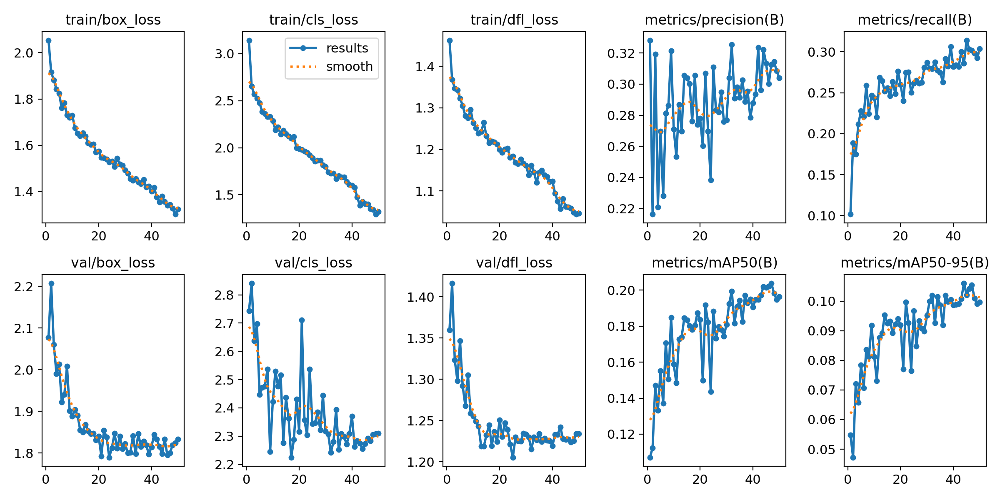

In [ ]:
# Mostrar la gráfica de métricas generada durante el entrenamiento
from pathlib import Path
import PIL.Image

# Ruta a la carpeta donde se guardaron los resultados del entrenamiento
result_dir = Path("runs/detect/limon_detector_yolov9")
metrics_img = result_dir / "results.png"

# Mostrar la imagen si existe
if metrics_img.exists():
    display(PIL.Image.open(metrics_img))
else:
    print("No se encontró la imagen de resultados.")

In [ ]:
import pandas as pd
from pathlib import Path

# Ruta al archivo CSV generado durante el entrenamiento
result_dir = Path("runs/detect/limon_detector_yolov9")
csv_path = result_dir / "results.csv"

# Cargar el CSV con las métricas por época
df = pd.read_csv(csv_path)

# Lista de métricas a extraer (entrenamiento, validación y desempeño)
metrics_to_extract = [
    'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
    'val/box_loss', 'val/cls_loss', 'val/dfl_loss',
    'metrics/precision(B)', 'metrics/recall(B)',
    'metrics/mAP50(B)', 'metrics/mAP50-95(B)'
]

# Mostrar los valores de estas métricas en la última época
print("Valores en la última época:\n")
for metric in metrics_to_extract:
    last_value = df[metric].iloc[-1]
    print(f"{metric}: {last_value:.4f}")

Valores en la última época:

train/box_loss: 1.3230
train/cls_loss: 1.3193
train/dfl_loss: 1.0459
val/box_loss: 1.8337
val/cls_loss: 2.3100
val/dfl_loss: 1.2339
metrics/precision(B): 0.3040
metrics/recall(B): 0.3036
metrics/mAP50(B): 0.1963
metrics/mAP50-95(B): 0.0997



image 1/1 /kaggle/working/Enfermedades-en-limon-persa-1/valid/images/IMG_E0246_JPG_jpg.rf.d8c7137664556ca1131ccc472ce6d3ba.jpg: 640x384 3 Hoja huanglongbings, 8 Limon persas, 16.8ms
Speed: 2.5ms preprocess, 16.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 384)
Results saved to runs/detect/limon_detector_yolov94


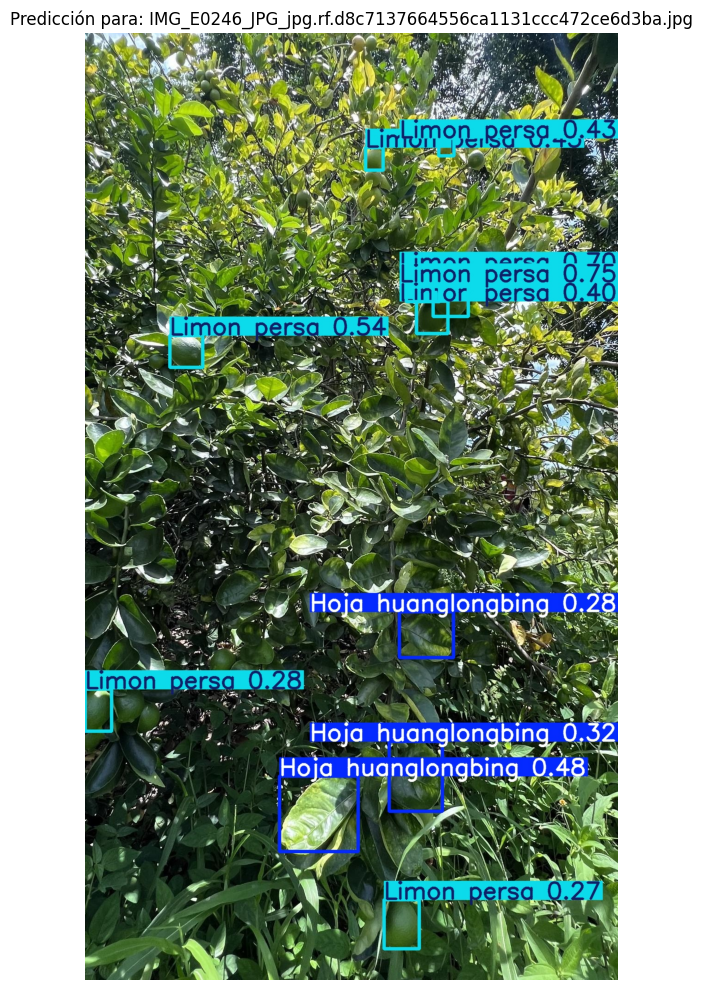

In [ ]:
# Realizar inferencia sobre una imagen aleatoria del conjunto de validación

import os
import random
import glob
import cv2
import matplotlib.pyplot as plt

# Directorio de imágenes de validación
valid_images_dir = os.path.join(dataset.location, "valid/images")

# Obtener lista de imágenes disponibles
image_paths = glob.glob(os.path.join(valid_images_dir, "*.jpg"))

# Verificar que existan imágenes
if not image_paths:
    raise FileNotFoundError("No se encontraron imágenes en el directorio de validación.")

# Seleccionar una imagen aleatoria
single_image_path = random.choice(image_paths)

# Ejecutar predicción con el modelo YOLOv9
modelo.predict(source=single_image_path, save=True, batch=1, device=0)

# Nombres de clases (usado solo como referencia para visualización o análisis posterior)
class_names = [
    "Deficiencia de Hierro", "Hoja Sana", "Hoja con Oidio", "Hoja huanglongbing",
    "Hoja mancha grasienta", "Hoja mordida", "Limon persa", "Mancha Grasienta",
    "Mordedura", "Oidio", "deficiencia de potasio", "huanglongbing"
]

# Buscar la carpeta de resultados más reciente
result_folders = sorted(glob.glob("runs/detect/*"), key=os.path.getmtime, reverse=True)
latest_result = result_folders[0]

# Buscar las imágenes predichas dentro de la carpeta
pred_images = glob.glob(os.path.join(latest_result, "*.jpg"))

# Mostrar la primera imagen predicha encontrada
if pred_images:
    img_path = pred_images[0]
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(img_rgb)
    ax.set_title(f"Predicción para: {os.path.basename(single_image_path)}")
    ax.axis('off')
    plt.tight_layout()
    plt.show()
else:
    print("No se encontró ninguna imagen predicha.")

In [ ]:
import yaml

# Cargar el archivo data.yaml existente
with open('dataset_yolov9_2clases/data.yaml') as f:
    datos = yaml.safe_load(f)

# Añadir la ruta del conjunto de prueba (test)
datos['test'] = 'test/images'

# Guardar nuevamente el archivo con la ruta de test incluida
with open('dataset_yolov9_2clases/data.yaml', 'w') as f:
    yaml.safe_dump(datos, f)

Ultralytics 8.3.146 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv9t summary (fused): 197 layers, 1,971,174 parameters, 0 gradients, 7.6 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 4222.3±835.1 MB/s, size: 537.2 KB)


val: Scanning /kaggle/working/dataset_yolov9_2clases/test/labels... 115 images, 0 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<00:00, 1345.74it/s]

val: New cache created: /kaggle/working/dataset_yolov9_2clases/test/labels.cache
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 188, len(boxes) = 1142. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]
invalid value encountered in less
invalid value encountered in less


                   all        115       1142      0.373      0.302       0.25      0.125
    Hoja huanglongbing        105        785      0.379      0.254      0.227      0.113
           Limon persa         93        357      0.367       0.35      0.274      0.137
Speed: 0.2ms preprocess, 11.3ms inference, 0.0ms loss, 6.1ms postprocess per image
Results saved to runs/val/exp_test
Test metrics:
  mp:    0.373
  mr:    0.302
  mAP50: 0.250
  mAP:   0.125



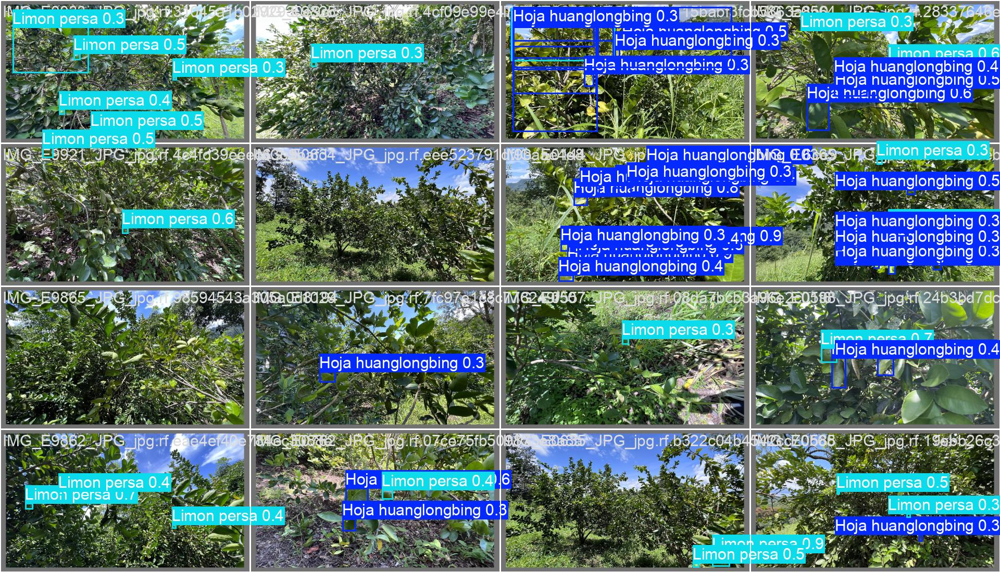

NameError: name 'val_batch2_pred' is not defined

In [ ]:
from ultralytics import YOLO
from pathlib import Path
import PIL.Image

# Cargar el modelo entrenado
model = YOLO("runs/detect/limon_detector_yolov9/weights/best.pt")

# Evaluar el modelo sobre el conjunto de prueba
res_test = model.val(
    data="dataset_yolov9_2clases/data.yaml",  # Dataset con división de test
    split="test",                             # Usar partición de test
    plots=True,                               # Generar visualizaciones (matriz de confusión, PR, etc.)
    save=True,                                # Guardar resultados en disco
    project="runs/val",                       # Carpeta raíz de resultados
    name="exp_test",                          # Subcarpeta para esta evaluación
    exist_ok=True                             # Sobrescribir si ya existía
)

# Mostrar métricas numéricas de evaluación
mp    = res_test.box.mp
mr    = res_test.box.mr
mAP50 = res_test.box.map50
mAP   = res_test.box.map

print(f"Test metrics:\n"
      f"  mp:    {mp:.3f}\n"
      f"  mr:    {mr:.3f}\n"
      f"  mAP50: {mAP50:.3f}\n"
      f"  mAP:   {mAP:.3f}\n")

# Visualizar una imagen de predicción del batch evaluado
metrics_img = Path("runs/val/exp_test") / "val_batch0_pred.jpg"
if metrics_img.exists():
    display(PIL.Image.open(metrics_img))
else:
    print("No encontré results.png en runs/val/exp_test")

Imagen seleccionada: dataset_yolov9_2clases/test/images/IMG_E0111_JPG_jpg.rf.c5eaa07e6b1640a3e42d0fab1658afeb.jpg

image 1/1 /kaggle/working/dataset_yolov9_2clases/test/images/IMG_E0111_JPG_jpg.rf.c5eaa07e6b1640a3e42d0fab1658afeb.jpg: 640x384 4 Hoja huanglongbings, 6 Limon persas, 17.8ms
Speed: 2.2ms preprocess, 17.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 384)


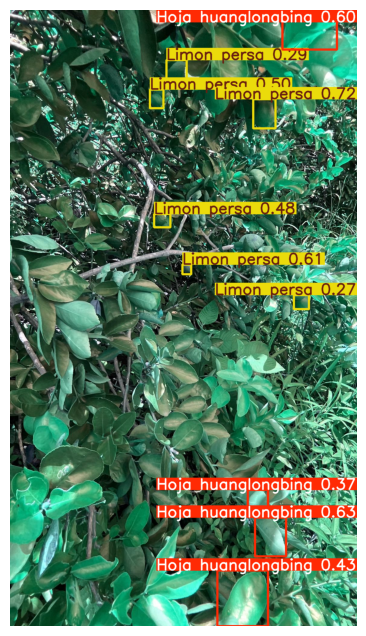


Detecciones:
 - Limon persa: conf=0.72, bbox=(807,297,882,393)
 - Hoja huanglongbing: conf=0.63, bbox=(814,1688,916,1817)
 - Limon persa: conf=0.61, bbox=(572,847,602,878)
 - Hoja huanglongbing: conf=0.60, bbox=(904,0,1085,131)
 - Limon persa: conf=0.50, bbox=(465,265,510,326)
 - Limon persa: conf=0.48, bbox=(478,678,533,722)
 - Hoja huanglongbing: conf=0.43, bbox=(688,1863,857,2048)
 - Hoja huanglongbing: conf=0.37, bbox=(790,1596,856,1685)
 - Limon persa: conf=0.29, bbox=(519,166,586,236)
 - Limon persa: conf=0.27, bbox=(942,948,992,994)


In [ ]:
import random
import glob
from pathlib import Path
from ultralytics import YOLO
import matplotlib.pyplot as plt

# 1) Cargar el modelo entrenado
model = YOLO("runs/detect/limon_detector_yolov9/weights/best.pt")

# 2) Obtener lista de imágenes en el conjunto de prueba
test_paths = glob.glob("dataset_yolov9_2clases/test/images/*.jpg")
if not test_paths:
    raise FileNotFoundError("No se encontraron imágenes en dataset_yolov9_2clases/images/test")

# 3) Seleccionar una imagen aleatoria
img_path = random.choice(test_paths)
print("Imagen seleccionada:", img_path)

# 4) Realizar inferencia sobre la imagen (devuelve una lista de resultados)
results = model.predict(source=img_path, save=False, show=False)

# 5) Visualizar la imagen con las anotaciones generadas por el modelo
annotated = results[0].plot()  # imagen con cajas dibujadas
plt.figure(figsize=(8,8))
plt.imshow(annotated)
plt.axis('off')
plt.show()

# 6) Mostrar las detecciones en texto: clase, confianza y coordenadas del bounding box
print("\nDetecciones:")
for box in results[0].boxes:
    cls_id = int(box.cls[0])
    cls_name = results[0].names[cls_id]
    conf    = float(box.conf[0])
    x1, y1, x2, y2 = box.xyxy[0].tolist()
    print(f" - {cls_name}: conf={conf:.2f}, bbox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")

### 🧪 Detección de Falsos Positivos y Entrenamiento con 3 Clases (YOLOv9)

En esta sección se realiza un proceso completo para extender el modelo de detección de enfermedades en limón persa a un caso de 3 clases, incorporando los **falsos positivos** de HLB como una nueva clase.

---

#### 🧩 1. Generación del nuevo dataset con falsos positivos (`no_hoja_huanglongbing`)
- Se parte del dataset previamente filtrado con 2 clases: `"Hoja huanglongbing"` y `"Limon persa"`.
- Se utiliza el modelo entrenado con estas 2 clases para predecir sobre todas las imágenes de `train`, `valid` y `test`.
- Se identifican **falsos positivos** (detecciones HLB sin presencia real en ground truth).
- Se genera un nuevo dataset llamado `dataset_fp_hlb_full_v2` con:
  - Clase 0: `"limon_persa"`
  - Clase 1: `"hoja_huanglongbing"`
  - Clase 2: `"no_hoja_huanglongbing"` (falsos positivos de HLB)
- Se crea automáticamente un nuevo archivo `data.yaml` para el entrenamiento de 3 clases.

---

#### ⚙️ 2. Entrenamiento del modelo con 3 clases
- Se carga el modelo con pesos anteriores entrenado en 2 clases.
- Se entrena nuevamente con el nuevo dataset incluyendo la clase de falsos positivos.
- Configuración del entrenamiento:
  - `epochs = 50`
  - `imgsz = 640`
  - `batch = 18`
  - `device = [0, 1]`
- El experimento se guarda en: `runs/detect/limon_detector_yolov9_3clases/`.

---

#### 📊 3. Visualización y análisis de métricas de entrenamiento
- Se muestra la imagen `results.png` con la evolución de pérdidas y métricas.
- Se cargan los valores del archivo `results.csv` y se imprimen:
  - Pérdidas de caja, clasificación y distribución (`box_loss`, `cls_loss`, `dfl_loss`)
  - Precisión, Recall, mAP@50, mAP@50-95

---

#### 🖼️ 4. Inferencia visual con el modelo de 3 clases
- Se selecciona una imagen aleatoria del conjunto de validación original.
- Se realiza inferencia con el modelo `limon_detector_yolov9_3clases`.
- Se visualiza la imagen con las detecciones realizadas.
- La lista de clases mostrada es de referencia (no está alineada con las 3 clases reales del modelo).

---

> ⚠️ Nota: Para evitar confusión en la visualización, se recomienda ajustar la lista `class_names` a:
> `["limon_persa", "hoja_huanglongbing", "no_hoja_huanglongbing"]`

---

✅ Este proceso permite crear un modelo más robusto que **distingue entre verdaderos y falsos positivos de HLB**, útil en escenarios donde el sobrediagnóstico puede llevar a decisiones incorrectas.


In [ ]:
import os
import shutil
import yaml
from pathlib import Path
from ultralytics import YOLO

# ---------------------------
#  Parámetros
# ---------------------------

orig = Path("dataset_yolov9_2clases")  # Ruta al dataset original con 2 clases
splits = ["train", "valid", "test"]   # Divisiones del dataset a procesar

# Clases originales (YOLO: índice 0 = HLB, índice 1 = Limón)
classes_orig = ["Hoja huanglongbing", "Limon persa"]

# Nuevas clases: incluye una clase adicional para falsos positivos de HLB
classes_new = ["limon_persa", "hoja_huanglongbing", "no_hoja_huanglongbing"]

# Carpeta de salida para el nuevo dataset
out = Path("dataset_fp_hlb_full_v2")

# Ruta al modelo entrenado con las dos clases originales
model_pt = "runs/detect/limon_detector_yolov9/weights/best.pt"

# ---------------------------
#  1) Predecir sobre cada división del dataset
# ---------------------------

model = YOLO(model_pt)
for split in splits:
    model.predict(
        source=orig/split/"images",  # Carpeta de imágenes a procesar
        save=True,                   # Guardar predicciones
        save_txt=True,               # Guardar etiquetas YOLO .txt
        project="runs/fp_hlb",       # Carpeta base de salida
        name=split,                  # Subcarpeta por división
        exist_ok=True                # Sobrescribir si ya existía
    )

# ---------------------------
#  2) Crear estructura del nuevo dataset
# ---------------------------

for split in splits:
    (out/split/"images").mkdir(parents=True, exist_ok=True)
    (out/split/"labels").mkdir(parents=True, exist_ok=True)

# ---------------------------
#  Helpers para leer archivos de etiquetas
# ---------------------------

def read_label_lines(path: Path):
    """Lee líneas del archivo .txt de etiquetas (ground truth)."""
    return path.read_text().splitlines() if path.exists() else []

def read_pred_lines(path: Path):
    """Lee predicciones (clase y bbox), ignorando la confianza."""
    lines = []
    if not path.exists():
        return lines
    for ln in path.read_text().splitlines():
        parts = ln.split()
        cls, x, y, w, h = parts[:5]
        lines.append((int(cls), x, y, w, h))
    return lines

# Mapeo de índices de clase original → nuevos índices
# HLB (0) → 1, Limón (1) → 0
map_gt = {0: 1, 1: 0}

# ---------------------------
#  3) Procesar y generar etiquetas nuevas por cada imagen
# ---------------------------

for split in splits:
    gt_img_dir = orig/split/"images"
    gt_lbl_dir = orig/split/"labels"
    pr_lbl_dir = Path("runs")/"fp_hlb"/split/"labels"

    for img_file in gt_img_dir.iterdir():
        name = img_file.stem

        # 3.1) Leer etiquetas GT y predicciones
        gt_lines = read_label_lines(gt_lbl_dir/f"{name}.txt")
        pr_boxes = read_pred_lines(pr_lbl_dir/f"{name}.txt")

        # 3.2) Verificar si hay HLB en el ground truth
        has_hlb_gt = any(int(ln.split()[0]) == 0 for ln in gt_lines)

        # 3.3) Extraer falsos positivos: predicciones HLB donde no había HLB real
        fp_hlb = [
            (cls, x, y, w, h)
            for cls, x, y, w, h in pr_boxes
            if cls == 0 and not has_hlb_gt
        ]

        # 3.4) Remapear las clases GT al nuevo esquema
        new_lines = []
        for ln in gt_lines:
            parts = ln.split()
            cls_orig = int(parts[0])
            if cls_orig in map_gt:
                new_cls = map_gt[cls_orig]
                new_lines.append(" ".join([str(new_cls)] + parts[1:]))

        # 3.5) Añadir falsos positivos como clase 2
        for _, x, y, w, h in fp_hlb:
            new_lines.append(f"2 {x} {y} {w} {h}")

        # 3.6) Si no hay anotaciones nuevas, omitir imagen
        if not new_lines:
            continue

        # 3.7) Copiar imagen al nuevo dataset
        dst_img = out/split/"images"/img_file.name
        shutil.copy2(img_file, dst_img)

        # 3.8) Guardar archivo de etiquetas actualizado
        (out/split/"labels"/f"{name}.txt").write_text("\n".join(new_lines))

# ---------------------------
#  4) Crear archivo data.yaml para el nuevo dataset
# ---------------------------

data = {
    'path': str(out),
    'train': os.path.join("train", "images"),
    'val':   os.path.join("valid", "images"),
    'test':  os.path.join("test", "images"),
    'nc':    len(classes_new),
    'names': classes_new
}
with open(out/"data.yaml", 'w') as f:
    yaml.safe_dump(data, f, sort_keys=False)

print("✅ Dataset completo de detección con falsos positivos creado en:", out)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/2772 /kaggle/working/dataset_yolov9_2clases/train/images/2709939_jpg.rf.6ba058c34df1b5b267fbc38c3f538009.jpg: 480x640 7 Hoja huanglongbings, 5 Limon persas, 52.3ms
image 2/2772 /kaggle/working/dataset_yolov9_2clases/train/images/2709939_jpg.rf.aeb120e29642d2a078726ff8710ca516.jpg: 480x640 6 Hoja huanglongbings, 6 Limon persas, 17.4ms
image 3/2772 /kaggle/working/dataset_yolov9_2clases/train/images/2709939_jpg.rf.c4437bd1bd03700fa48ea86e7cbd3f7b

In [ ]:
# Cargar el modelo preentrenado con pesos anteriores (2 clases)
modelo = YOLO("runs/detect/limon_detector_yolov9/weights/best.pt")

# Entrenar el modelo con el nuevo dataset que incluye falsos positivos (3 clases)
modelo.train(
    data="dataset_fp_hlb_full_v2/data.yaml",  # Ruta al nuevo archivo data.yaml
    epochs=50,                                # Número de épocas
    imgsz=640,                                # Tamaño de las imágenes (640x640)
    batch=18,                                 # Tamaño del batch
    name="limon_detector_yolov9_3clases",     # Nombre del experimento
    device=[0, 1]                              # GPUs a usar (ajustar según disponibilidad)
)

Ultralytics 8.3.146 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
                                                        CUDA:1 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=18, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset_fp_hlb_full_v2/data.yaml, degrees=0.0, deterministic=True, device=0,1, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=runs/detect/limon_detector_yolov9/weights/best.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=limon_detector_yolov9_3clas

train: Scanning /kaggle/working/dataset_fp_hlb_full_v2/train/labels... 2772 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2772/2772 [00:02<00:00, 1029.82it/s]


train: New cache created: /kaggle/working/dataset_fp_hlb_full_v2/train/labels.cache
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 8874, len(boxes) = 24259. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2355.0±1578.1 MB/s, size: 593.3 KB)


val: Scanning /kaggle/working/dataset_fp_hlb_full_v2/valid/labels... 234 images, 0 backgrounds, 0 corrupt: 100%|██████████| 234/234 [00:00<00:00, 1515.49it/s]


val: New cache created: /kaggle/working/dataset_fp_hlb_full_v2/valid/labels.cache
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 490, len(boxes) = 1911. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
Plotting labels to runs/detect/limon_detector_yolov9_3clases2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 221 weight(decay=0.0), 228 weight(decay=0.0005625000000000001), 227 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/limon_detector_yolov9_3clases2
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.02G      1.418      2.556      1.121         99        640: 100%|██████████| 154/154 [01:02<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.96it/s]


                   all        234       1911      0.564       0.17       0.13     0.0656

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.03G      1.432      1.838      1.128         91        640: 100%|██████████| 154/154 [00:58<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.18it/s]


                   all        234       1911      0.555       0.18      0.133     0.0653

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.04G       1.47      1.866      1.139         97        640: 100%|██████████| 154/154 [00:56<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.76it/s]


                   all        234       1911      0.523      0.181      0.121     0.0613

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.23G      1.489      1.884      1.153        141        640: 100%|██████████| 154/154 [00:56<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.32it/s]


                   all        234       1911      0.492      0.171      0.101     0.0518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.24G      1.488      1.873      1.154        157        640: 100%|██████████| 154/154 [00:56<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.34it/s]


                   all        234       1911      0.497      0.172      0.107     0.0549

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.26G      1.465      1.794      1.146        164        640: 100%|██████████| 154/154 [00:56<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.34it/s]


                   all        234       1911      0.491      0.171       0.11     0.0567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.27G      1.487      1.774      1.131        118        640: 100%|██████████| 154/154 [00:56<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.47it/s]


                   all        234       1911      0.523      0.188      0.129     0.0682

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.28G       1.46      1.742      1.135        131        640: 100%|██████████| 154/154 [00:55<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.96it/s]


                   all        234       1911      0.521      0.186      0.123     0.0646

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.29G      1.444      1.744      1.142        185        640: 100%|██████████| 154/154 [00:54<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.53it/s]


                   all        234       1911      0.543       0.19      0.133     0.0701

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.31G      1.477      1.726      1.133         92        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.85it/s]


                   all        234       1911      0.553      0.183      0.134     0.0696

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.32G      1.442      1.641      1.136        188        640: 100%|██████████| 154/154 [00:54<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.90it/s]


                   all        234       1911      0.537      0.173      0.129     0.0678

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.33G      1.423      1.668      1.121        167        640: 100%|██████████| 154/154 [00:55<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.22it/s]


                   all        234       1911      0.551      0.192      0.136     0.0707

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.34G      1.411      1.601      1.123        132        640: 100%|██████████| 154/154 [00:55<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.51it/s]


                   all        234       1911      0.531      0.185      0.135     0.0726

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.36G      1.419      1.653      1.134        137        640: 100%|██████████| 154/154 [00:55<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.25it/s]


                   all        234       1911      0.523      0.183      0.135     0.0673

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.37G      1.416      1.633      1.113        156        640: 100%|██████████| 154/154 [00:54<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.96it/s]


                   all        234       1911      0.537      0.196      0.136     0.0715

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.39G      1.397      1.589      1.099        140        640: 100%|██████████| 154/154 [00:56<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.95it/s]


                   all        234       1911      0.544      0.197       0.13     0.0684

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.39G      1.389      1.579      1.107        129        640: 100%|██████████| 154/154 [00:55<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.30it/s]


                   all        234       1911      0.532      0.187      0.126     0.0648

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50       2.4G      1.407       1.62      1.109        108        640: 100%|██████████| 154/154 [00:55<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.39it/s]


                   all        234       1911      0.512      0.184       0.11      0.057

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.42G      1.363      1.505      1.099        157        640: 100%|██████████| 154/154 [00:54<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.41it/s]


                   all        234       1911      0.544      0.191      0.133     0.0691

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.43G      1.363      1.514      1.086        109        640: 100%|██████████| 154/154 [00:54<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.36it/s]


                   all        234       1911      0.182      0.185      0.115     0.0565

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.44G      1.357      1.509      1.085        152        640: 100%|██████████| 154/154 [00:54<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.92it/s]


                   all        234       1911      0.515      0.187      0.109     0.0572

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.45G      1.351       1.49      1.088        137        640: 100%|██████████| 154/154 [00:54<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.46it/s]


                   all        234       1911      0.541      0.192      0.125     0.0658

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.46G      1.337      1.487      1.089        137        640: 100%|██████████| 154/154 [00:55<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.09it/s]


                   all        234       1911       0.21      0.186      0.128     0.0659

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.47G      1.334      1.476      1.075        194        640: 100%|██████████| 154/154 [00:55<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.17it/s]


                   all        234       1911      0.208      0.198       0.13     0.0678

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.49G      1.336      1.422      1.076        155        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.23it/s]


                   all        234       1911      0.213       0.19      0.135      0.069

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50       2.5G      1.326      1.414      1.073         83        640: 100%|██████████| 154/154 [00:55<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.55it/s]


                   all        234       1911      0.205      0.172      0.117     0.0592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.51G       1.37      1.445      1.071        117        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.28it/s]


                   all        234       1911      0.192      0.191       0.12     0.0623

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.52G      1.325      1.416      1.072        110        640: 100%|██████████| 154/154 [00:55<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.16it/s]


                   all        234       1911      0.192      0.188      0.131     0.0676

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.54G      1.338      1.404       1.07        140        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.11it/s]


                   all        234       1911      0.209      0.184      0.132     0.0691

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.55G      1.313      1.377      1.066        139        640: 100%|██████████| 154/154 [00:54<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.53it/s]


                   all        234       1911      0.209      0.197      0.131     0.0666

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.56G      1.308      1.368      1.053        154        640: 100%|██████████| 154/154 [00:54<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.53it/s]


                   all        234       1911      0.208      0.189      0.131     0.0699

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.57G      1.279      1.342      1.069         98        640: 100%|██████████| 154/154 [00:55<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.60it/s]


                   all        234       1911      0.188      0.197      0.125     0.0639

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.58G      1.274      1.336      1.052        127        640: 100%|██████████| 154/154 [00:54<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.11it/s]


                   all        234       1911      0.195       0.22      0.138       0.07

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50       2.6G      1.287      1.309      1.038        174        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.52it/s]


                   all        234       1911      0.214      0.205      0.133     0.0693

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.61G      1.271      1.336      1.057         98        640: 100%|██████████| 154/154 [00:54<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.99it/s]


                   all        234       1911      0.207      0.192      0.128     0.0657

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.62G      1.271       1.32      1.063        151        640: 100%|██████████| 154/154 [00:55<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.51it/s]


                   all        234       1911      0.201      0.202      0.133     0.0687

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.63G      1.284      1.323       1.05        185        640: 100%|██████████| 154/154 [00:54<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.31it/s]


                   all        234       1911      0.188      0.214      0.129     0.0673

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.65G      1.263      1.302      1.053         97        640: 100%|██████████| 154/154 [00:54<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.44it/s]


                   all        234       1911      0.212      0.208      0.133     0.0687

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.66G      1.263      1.284      1.039        126        640: 100%|██████████| 154/154 [00:55<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.44it/s]


                   all        234       1911      0.198      0.213      0.135     0.0711

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.67G      1.255      1.264      1.045        149        640: 100%|██████████| 154/154 [00:55<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.64it/s]


                   all        234       1911      0.207      0.195      0.132     0.0678
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


  0%|          | 0/154 [00:00<?, ?it/s]


      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.68G      1.264      1.256      1.022         50        640: 100%|██████████| 154/154 [00:56<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.42it/s]


                   all        234       1911      0.209      0.201      0.131     0.0679

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50       2.7G      1.222      1.151      1.003         53        640: 100%|██████████| 154/154 [00:54<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.06it/s]


                   all        234       1911      0.211      0.196       0.13     0.0674

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.71G      1.199      1.089     0.9871         42        640: 100%|██████████| 154/154 [00:52<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.57it/s]


                   all        234       1911      0.228      0.208      0.132      0.068

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.72G      1.228      1.126      1.004         60        640: 100%|██████████| 154/154 [00:54<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.44it/s]


                   all        234       1911      0.213      0.219      0.133     0.0695

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.73G      1.201      1.115     0.9982         59        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.65it/s]


                   all        234       1911      0.258      0.197      0.134     0.0699

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.74G      1.205      1.118     0.9986         71        640: 100%|██████████| 154/154 [00:54<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.46it/s]


                   all        234       1911      0.244      0.206      0.136     0.0709

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.76G      1.192      1.097     0.9906        100        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.28it/s]


                   all        234       1911      0.259      0.205      0.138     0.0722

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.77G       1.19      1.091     0.9893         68        640: 100%|██████████| 154/154 [00:55<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.37it/s]


                   all        234       1911      0.256      0.198      0.133     0.0694

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.78G      1.163      1.059     0.9832         46        640: 100%|██████████| 154/154 [00:53<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  6.38it/s]


                   all        234       1911      0.263      0.193      0.132     0.0687

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.79G      1.181      1.087      0.984         87        640: 100%|██████████| 154/154 [00:54<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:01<00:00,  6.51it/s]


                   all        234       1911      0.259      0.197      0.136     0.0703

50 epochs completed in 0.809 hours.
Optimizer stripped from runs/detect/limon_detector_yolov9_3clases2/weights/last.pt, 4.6MB
Optimizer stripped from runs/detect/limon_detector_yolov9_3clases2/weights/best.pt, 4.6MB

Validating runs/detect/limon_detector_yolov9_3clases2/weights/best.pt...
Ultralytics 8.3.146 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
                                                        CUDA:1 (Tesla T4, 15095MiB)
YOLOv9t summary (fused): 197 layers, 1,971,369 parameters, 0 gradients, 7.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:04<00:00,  3.11it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        234       1911      0.531      0.185      0.134     0.0725
           limon_persa        181        724      0.384      0.385      0.287       0.16
    hoja_huanglongbing        200       1159      0.208      0.169     0.0929     0.0411
 no_hoja_huanglongbing         14         28          1          0     0.0231     0.0169
Speed: 0.3ms preprocess, 3.9ms inference, 0.0ms loss, 4.4ms postprocess per image
Results saved to runs/detect/limon_detector_yolov9_3clases2


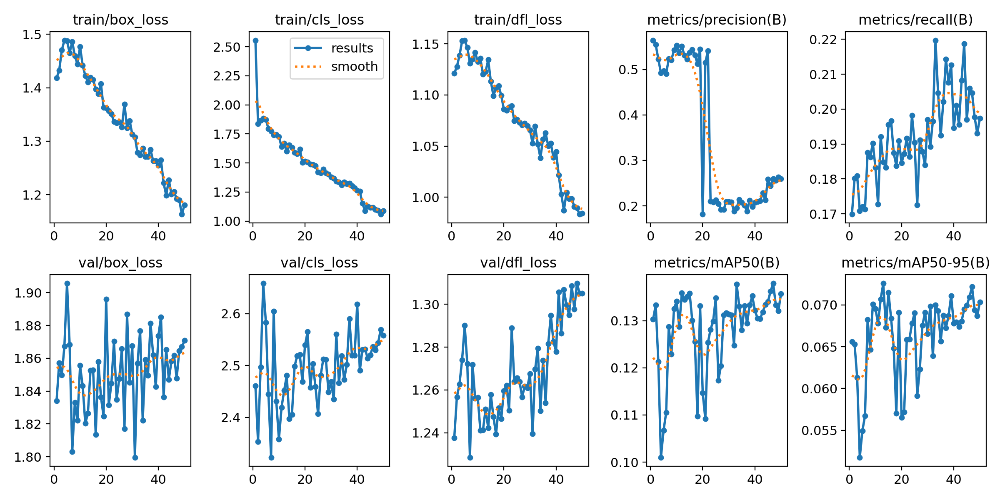

In [ ]:
#@title **Mostrar gráficas de entrenamiento**
from pathlib import Path
import PIL.Image

# Ruta a la carpeta donde se guardaron los resultados del entrenamiento
result_dir = Path("runs/detect/limon_detector_yolov9_3clases2")
metrics_img = result_dir / "results.png"  # Imagen con las métricas por época

# Mostrar la imagen si existe
if metrics_img.exists():
    display(PIL.Image.open(metrics_img))
else:
    print("No se encontró la imagen de resultados.")

In [ ]:
import pandas as pd
from pathlib import Path

# Ruta al archivo CSV con métricas del entrenamiento del modelo de 2 clases
result_dir = Path("runs/detect/limon_detector_yolov9_3clases2")
csv_path = result_dir / "results.csv"

# Cargar el archivo CSV como DataFrame
df = pd.read_csv(csv_path)

# Lista de métricas que se desean visualizar (entrenamiento, validación, precisión, recall y mAP)
metrics_to_extract = [
    'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
    'val/box_loss', 'val/cls_loss', 'val/dfl_loss',
    'metrics/precision(B)', 'metrics/recall(B)',
    'metrics/mAP50(B)', 'metrics/mAP50-95(B)'
]

# Mostrar el valor de cada métrica en la última época del entrenamiento
print("Valores en la última época:\n")
for metric in metrics_to_extract:
    last_value = df[metric].iloc[-1]
    print(f"{metric}: {last_value:.4f}")

Valores en la última época:

train/box_loss: 1.1808
train/cls_loss: 1.0875
train/dfl_loss: 0.9840
val/box_loss: 1.8708
val/cls_loss: 2.5582
val/dfl_loss: 1.3051
metrics/precision(B): 0.2594
metrics/recall(B): 0.1974
metrics/mAP50(B): 0.1357
metrics/mAP50-95(B): 0.0703



image 1/1 /kaggle/working/Enfermedades-en-limon-persa-1/valid/images/IMG_E0235_JPG_jpg.rf.7bef5b55c47d74d27f5585ac82b2a2d6.jpg: 640x384 6 limon_persas, 22 hoja_huanglongbings, 16.6ms
Speed: 2.1ms preprocess, 16.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)
Results saved to runs/detect/limon_detector_yolov9_3clases28


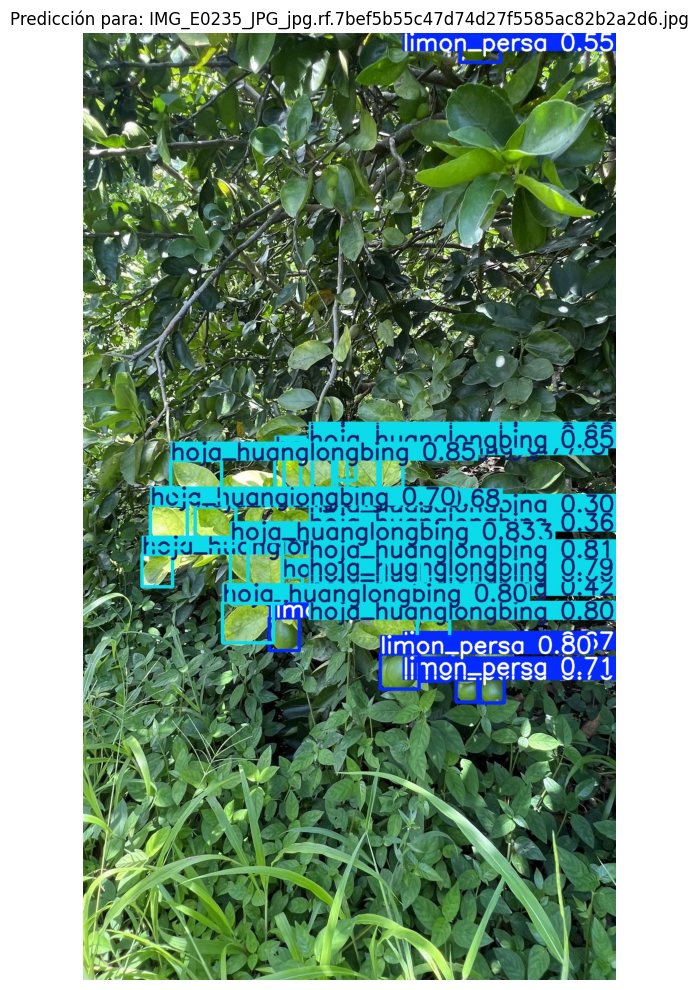

In [ ]:
import os
import random
import glob
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

# Buscar imágenes en el conjunto de validación del dataset original
valid_images_dir = os.path.join(dataset.location, "valid/images")
image_paths = glob.glob(os.path.join(valid_images_dir, "*.jpg"))

# Seleccionar aleatoriamente una imagen
if not image_paths:
    raise FileNotFoundError("No se encontraron imágenes en el directorio de validación.")
single_image_path = random.choice(image_paths)

# Realizar predicción sobre la imagen seleccionada
modelo.predict(source=single_image_path, save=True, batch=1, device=0)

# Lista de nombres de clases originales del dataset (usado solo como referencia visual)
class_names = [
    "Deficiencia de Hierro", "Hoja Sana", "Hoja con Oidio", "Hoja huanglongbing",
    "Hoja mancha grasienta", "Hoja mordida", "Limon persa", "Mancha Grasienta",
    "Mordedura", "Oidio", "deficiencia de potasio", "huanglongbing"
]

# Buscar la carpeta de resultados más reciente
result_folders = sorted(glob.glob("runs/detect/*"), key=os.path.getmtime, reverse=True)
latest_result = result_folders[0]

# Buscar las imágenes generadas por la predicción
pred_images = glob.glob(os.path.join(latest_result, "*.jpg"))

# Visualizar la primera imagen con predicción
if pred_images:
    img_path = pred_images[0]
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(img_rgb)
    ax.set_title(f"Predicción para: {os.path.basename(single_image_path)}")
    ax.axis('off')
    plt.tight_layout()
    plt.show()
else:
    print("No se encontró ninguna imagen predicha.")

### 🧪 Evaluación e Inferencia del Modelo YOLOv9 con 3 Clases

En esta sección se realiza la evaluación formal del modelo de 3 clases (`limon_detector_yolov9_3clases2`) y se aplica a una imagen aleatoria del conjunto de prueba para visualizar las predicciones.

---

#### 📏 1. Evaluación del modelo sobre conjunto de prueba (⚠️ error intencional)
- Se evalúa el modelo entrenado con 3 clases sobre el dataset de 2 clases (`dataset_yolov9_2clases`).
- Aunque se ejecuta correctamente, el conjunto de datos no corresponde a la estructura del modelo, lo que puede producir inconsistencias o métricas irrelevantes.
- Se generan automáticamente:
  - `confusion_matrix.png`
  - `PR_curve.png`
  - `results.png`
  - `val_batch0_pred.jpg`

Se imprimen las métricas principales de la evaluación:
- Precisión media (`mp`)
- Recall (`mr`)
- mAP@0.5 (`mAP50`)
- mAP@0.5:0.95 (`mAP`)

---

#### 🖼️ 2. Inferencia puntual sobre una imagen de prueba
- Se selecciona una imagen aleatoria desde `dataset_fp_hlb_full_v2/test/images/`.
- Se ejecuta inferencia con el modelo entrenado.
- Se visualiza la imagen con sus predicciones utilizando `matplotlib`.
- Se imprimen en texto las detecciones realizadas, incluyendo:
  - Clase detectada
  - Confianza del modelo
  - Coordenadas del bounding box




Ultralytics 8.3.146 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv9t summary (fused): 197 layers, 1,971,369 parameters, 0 gradients, 7.6 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 114.9±20.9 MB/s, size: 573.0 KB)


val: Scanning /kaggle/working/dataset_yolov9_2clases/test/labels.cache... 115 images, 0 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<?, ?it/s]

WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 188, len(boxes) = 1142. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.25it/s]
invalid value encountered in less
invalid value encountered in less


                   all        115       1142    0.00991      0.305    0.00735    0.00375
           limon_persa        105        785      0.012      0.125    0.00794     0.0039
    hoja_huanglongbing         93        357    0.00784      0.485    0.00675     0.0036
Speed: 0.2ms preprocess, 14.6ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to runs/val/exp_test
Test metrics:
  mp:    0.010
  mr:    0.305
  mAP50: 0.007
  mAP:   0.004



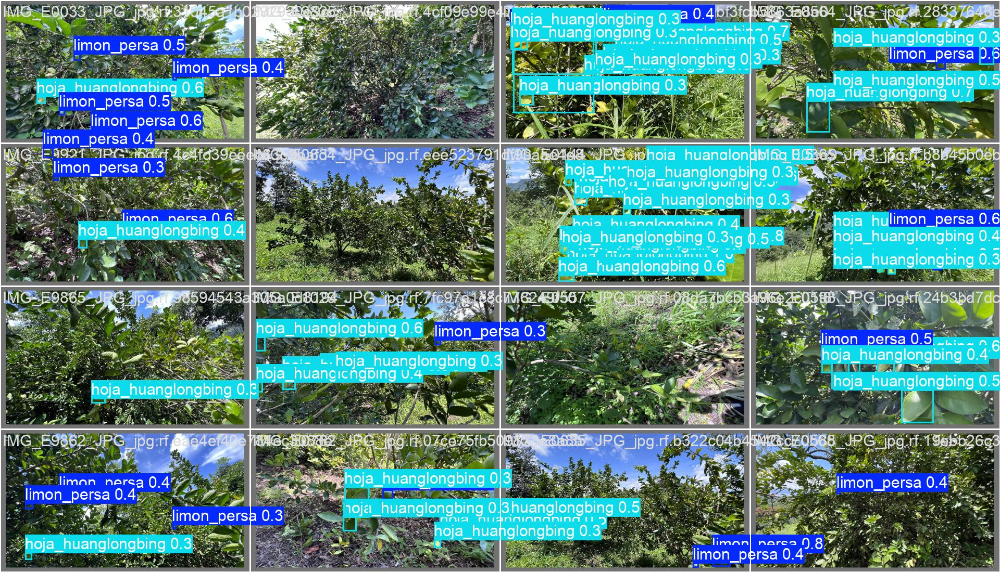

NameError: name 'val_batch2_pred' is not defined

In [ ]:
from ultralytics import YOLO
from pathlib import Path
import PIL.Image

# Cargar el modelo entrenado con 3 clases
model = YOLO("runs/detect/limon_detector_yolov9_3clases2/weights/best.pt")

# Evaluar el modelo sobre el conjunto de prueba del dataset original de 2 clases
res_test = model.val(
    data="dataset_yolov9_2clases/data.yaml",  # OJO: aquí aún se está usando el dataset anterior
    split="test",                             # Evaluación sobre partición de prueba
    plots=True,                               # Generar gráficos como matriz de confusión, PR, etc.
    save=True,                                # Guardar los gráficos en disco
    project="runs/val",                       # Carpeta raíz para los resultados
    name="exp_test",                          # Subcarpeta específica para esta evaluación
    exist_ok=True                             # Sobrescribe si ya existe
)

# Visualización esperada (guardado automático por Ultralytics):
# runs/val/exp_test/confusion_matrix.png
# runs/val/exp_test/PR_curve.png
# runs/val/exp_test/results.png

# Extraer y mostrar métricas principales
mp    = res_test.box.mp      # Precisión media
mr    = res_test.box.mr      # Recall medio
mAP50 = res_test.box.map50   # mAP@0.5 (IoU)
mAP   = res_test.box.map     # mAP@0.5:0.95 (IoU)

print(f"Test metrics:\n"
      f"  mp:    {mp:.3f}\n"
      f"  mr:    {mr:.3f}\n"
      f"  mAP50: {mAP50:.3f}\n"
      f"  mAP:   {mAP:.3f}\n")

# Visualizar la imagen del primer batch de prueba evaluado
metrics_img = Path("runs/val/exp_test") / "val_batch0_pred.jpg"
if metrics_img.exists():
    display(PIL.Image.open(metrics_img))
else:
    print("No se encontró val_batch0_pred.jpg en runs/val/exp_test")

Imagen seleccionada: dataset_fp_hlb_full_v2/test/images/IMG_E0474_JPG_jpg.rf.4db15f60e6646b93a1efc4604739315e.jpg

image 1/1 /kaggle/working/dataset_fp_hlb_full_v2/test/images/IMG_E0474_JPG_jpg.rf.4db15f60e6646b93a1efc4604739315e.jpg: 640x384 1 limon_persa, 5 hoja_huanglongbings, 17.3ms
Speed: 2.0ms preprocess, 17.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)


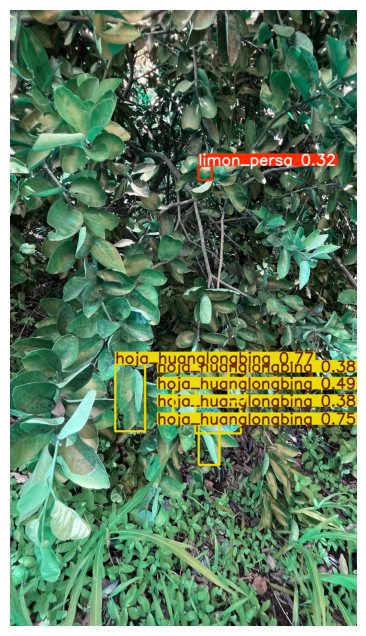


Detecciones:
 - hoja_huanglongbing: conf=0.77, bbox=(349,1176,449,1400)
 - hoja_huanglongbing: conf=0.75, bbox=(626,1378,696,1513)
 - hoja_huanglongbing: conf=0.49, bbox=(542,1261,615,1375)
 - hoja_huanglongbing: conf=0.38, bbox=(726,1204,780,1302)
 - hoja_huanglongbing: conf=0.38, bbox=(615,1319,767,1408)
 - limon_persa: conf=0.32, bbox=(625,518,670,566)


In [ ]:
import random
import glob
from pathlib import Path
from ultralytics import YOLO
import matplotlib.pyplot as plt

# 1) Carga tu modelo entrenado
model = YOLO("runs/detect/limon_detector_yolov9_3clases2/weights/best.pt")

# 2) Lista todas las imágenes de test
test_paths = glob.glob("dataset_fp_hlb_full_v2/test/images/*.jpg")
if not test_paths:
    raise FileNotFoundError("No se encontraron imágenes en dataset_yolov9_2clases/images/test")

# 3) Elige una al azar
img_path = random.choice(test_paths)
print("Imagen seleccionada:", img_path)

# 4) Ejecuta la predicción (devuelve una lista de Results; aquí solo uno)
results = model.predict(source=img_path, save=False, show=False)

# 5) Dibuja y muestra el resultado con matplotlib
#    .plot() devuelve un array con la imagen ya anotada
annotated = results[0].plot()
plt.figure(figsize=(8,8))
plt.imshow(annotated)
plt.axis('off')
plt.show()

# 6) Imprime las detecciones en texto
print("\nDetecciones:")
for box in results[0].boxes:  # cada box tiene .cls, .conf, .xyxy
    cls_id = int(box.cls[0])
    cls_name = results[0].names[cls_id]
    conf    = float(box.conf[0])
    x1, y1, x2, y2 = box.xyxy[0].tolist()
    print(f" - {cls_name}: conf={conf:.2f}, bbox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")
